## CODIGO ENTREGA 3

In [1]:
import praw
import pandas as pd
import datetime

In [24]:
#Creamos una variable que contenga la ruta de nuestro archivo csv ya previamente procesado

ubi_comentarios = r"C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_reddit.xlsx"
comentarios = pd.read_excel('comentarios_reddit.xlsx')


In [25]:
comentarios

,posts,title,num_comments,time_created,post_id,comment_body,Unnamed: 6
0,post,"Nueva tanda de despidos masivos en el Estado, ...",227.0,2024-06-29,1drfn40,NaN,NaN
1,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Ponganme en la movida: Esto es para profes/Alu...,NaN
2,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Gracias a este curso ya no cago a cintazos a m...,NaN
3,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Que ganas de cabecear el marco de una puerta q...,NaN
4,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Ahora si que el hincha de bokita va a dejar de...,NaN
...,...,...,...,...,...,...,...
20555,post,TN y eltrece tendrán editora de género,52.0,2021-03-08,m0l5tz,"No lo creo. Esa ""mayoría"" es cada vez menor.",NaN
20556,post,TN y eltrece tendrán editora de género,52.0,2021-03-08,m0l5tz,"Si, o sea por ejemplo puedo ejercer como elect...",NaN
20557,post,TN y eltrece tendrán editora de género,52.0,2021-03-08,m0l5tz,Me explicas cumatas mujeres dejan de subir aco...,NaN
20558,post,TN y eltrece tendrán editora de género,52.0,2021-03-08,m0l5tz,Todo lo que de visibilidad al problema ayuda.,NaN


In [26]:
#Instalamos las librerías nltk y spacy para procesamiento de lenguaje natural
!pip install nltk
!pip install spacy

In [27]:
!python -m spacy download es_core_news_sm

     ---------------------------------------- 0.0/12.9 MB ? eta -:--:--
     ---- ----------------------------------- 1.6/12.9 MB 11.9 MB/s eta 0:00:01
     ------------ --------------------------- 3.9/12.9 MB 10.7 MB/s eta 0:00:01
     ----------------- ---------------------- 5.8/12.9 MB 10.1 MB/s eta 0:00:01
     ------------------------ --------------- 7.9/12.9 MB 9.9 MB/s eta 0:00:01
     ------------------------------ -------- 10.0/12.9 MB 10.0 MB/s eta 0:00:01
     ---------------------------------- ----- 11.3/12.9 MB 9.5 MB/s eta 0:00:01
     ---------------------------------------- 12.9/12.9 MB 9.2 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


In [28]:
import nltk

import spacy
nlp = spacy.load('es_core_news_sm')

import string

In [29]:
#Accedemos a la columna del cuerpo de texto de comentarios en el df de comentarios de Reddit
# Remplazamos los comentarios en los que falte data por cadenas de texto vacías para no generar errores
comentarios['comment_body'] = comentarios['comment_body'].fillna('')

In [30]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Alessandro\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [31]:
# Convertimos los valores en comment_body a cadenas de texto
comentarios['comment_body'] = comentarios['comment_body'].astype(str)

### TOKENIZACION

In [32]:
# TOKENIZACION
# Aplicamos word_tokenize a cada elemento en la columna "comment_body"
# Almacenamos los tokens resultantes en una nueva columna llamada "comentarios_tokens"
comentarios['comentarios_tokens'] = comentarios['comment_body'].apply(
    lambda x: [token for token in nltk.word_tokenize(x, language='spanish') if token not in string.punctuation])

In [33]:
print(comentarios[['comentarios_tokens']])

                                      comentarios_tokens
0                                                     []
1      [Ponganme, en, la, movida, Esto, es, para, pro...
2      [Gracias, a, este, curso, ya, no, cago, a, cin...
3      [Que, ganas, de, cabecear, el, marco, de, una,...
4      [Ahora, si, que, el, hincha, de, bokita, va, a...
...                                                  ...
20555  [No, lo, creo, Esa, ``, mayoría, '', es, cada,...
20556  [Si, o, sea, por, ejemplo, puedo, ejercer, com...
20557  [Me, explicas, cumatas, mujeres, dejan, de, su...
20558  [Todo, lo, que, de, visibilidad, al, problema,...
20559                                                 []

[20560 rows x 1 columns]


In [34]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Alessandro\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [35]:
#Descargamos el módulo para filtrar stopwords en español

from nltk.corpus import stopwords
import re

# Descargar la lista de stopwords en español
stop_words = set(stopwords.words('spanish'))

In [36]:
# Agregamos palabras personalizadas a las stopwords en base a lo que leemos en los comentarios
palabras_personalizadas = {"si","ser","cosa","cosas","no","nose","vos","yo","mas","más","hace",
                           "hacer","ver","viste","ven","va","solo","sola","bien","iba","voy",
                           "van","va","cual","tan","da","doy","den","dan","de","ni", "las",
                           "che","Che","https","deleted", "ni","en","la","el","lo","las","les",
                           "este","esta","muy","que","donde","se","y","por","para","a","re",
                           "para","por","contra","desde","removed","si","mucho","muchas","me",
                           "mi","que","acá","como", "cuando","un","una", "uno","tambien",
                           "tampoco","esta","nos","todos","todas","te","mucho","mucha","muchos",
                           "pasa","siempre","nadie","bueno","mejor","sino","alguien","cómo","dos",
                           "cada","ahí","así","vas","vez","q","entones","misma","mismo", "´´", '""'}
stop_words.update(palabras_personalizadas)

In [37]:
# Con el método "apply",filtramos las stopwords en una nueva columna que crea los tokens sin las stopwords
# Con el método .lower nos aseguramos que el proceso sea case insensitive
comentarios['comentarios_tokens_filtrados'] = comentarios['comentarios_tokens'].apply(lambda x: [word for word in x if word.lower() not in stop_words])

# Vemos los tokens filtrados de los primeros títulos
print(comentarios[['comentarios_tokens_filtrados']].head(20))

                         comentarios_tokens_filtrados
0                                                  []
1   [Ponganme, movida, profes/Alumnos, quedaria, p...
2   [Gracias, curso, cago, cintazos, novia, drogo,...
3               [ganas, cabecear, marco, puerta, ...]
4        [Ahora, hincha, bokita, dejar, fajar, jermu]
5                                                  []
6   [tomás, criterio, agarrar, oraciones, largas, ...
7   [supone, desaprobas, curso, denuncian, machiru...
8   [papa, seguro, enfermos, curan, dejan, violent...
9   [Ufff, menos, mal, ví, tener, ganas, fumarme, ...
10                               [Educación, calidad]
11  [espina, preguntas, arrancan, ``, según, fulan...
12                            [curso, género, falopa]
13  [entonces, bajo, lógica, personas, dando, curs...
14  [acuerdan, años, avisamos, mierdas, SJW, paíse...
15  [Resumen, clase, personas, obsesionada, género...
16  [hacía, falta, man, simplemente, seleccionar, ...
17  [pésimas, preguntas, pid

In [38]:
# Creamos una lista para almacenar los tokens en un df
resultados = []

# Procesamos cada sublista en comentarios["comentarios_tokens_filtrados"]
for sublist in comentarios["comentarios_tokens_filtrados"]:
    # Eliminamos signos de puntuación usando una expresión regular
    sublist_limpia = [re.sub(r'[^\w\s]', '', word) for word in sublist]

    # Eliminamos cualquier token vacío resultante del proceso de limpieza
    sublist_limpia = [word for word in sublist_limpia if word]

    # Agregamos el resultado procesado a la lista de resultados
    resultados.append(sublist_limpia)

In [39]:
# Convertimos la lista de listas de resultados a un df
# Cada sublista va a ser una fila en el DataFrame
df = pd.DataFrame({'tokens': resultados})

print(df)

                                                  tokens
0                                                     []
1      [Ponganme, movida, profesAlumnos, quedaria, pr...
2      [Gracias, curso, cago, cintazos, novia, drogo,...
3                       [ganas, cabecear, marco, puerta]
4           [Ahora, hincha, bokita, dejar, fajar, jermu]
...                                                  ...
20555                             [creo, mayoría, menor]
20556  [ejemplo, puedo, ejercer, electricista, matric...
20557  [explicas, cumatas, mujeres, dejan, subir, aco...
20558                     [visibilidad, problema, ayuda]
20559                                                 []

[20560 rows x 1 columns]


In [40]:
# Agregamos la columna de tokens al DataFrame de comentarios
comentarios['tokens'] = resultados

# Limpiamos las demás columnas creadas en el proceso
comentarios = comentarios.drop(['comentarios_tokens', 'comentarios_tokens_filtrados'], axis=1)

In [41]:
# Creamos una función para eliminar signos de puntuación de una lista de tokens
def limpiar_tokens(tokens):
    tokens_limpios = [re.sub(r'[^\w\s]', '', token) for token in tokens]
    return [token for token in tokens_limpios if token]

# Aplicamos la función a la columna 'tokens'
comentarios['tokens'] = comentarios['tokens'].apply(limpiar_tokens)

In [42]:
comentarios.head(20)

,posts,title,num_comments,time_created,post_id,comment_body,Unnamed: 6,tokens
0,post,"Nueva tanda de despidos masivos en el Estado, ...",227.0,2024-06-29,1drfn40,,NaN,[]
1,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Ponganme en la movida: Esto es para profes/Alu...,NaN,"[Ponganme, movida, profesAlumnos, quedaria, pr..."
2,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Gracias a este curso ya no cago a cintazos a m...,NaN,"[Gracias, curso, cago, cintazos, novia, drogo,..."
3,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Que ganas de cabecear el marco de una puerta q...,NaN,"[ganas, cabecear, marco, puerta]"
4,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Ahora si que el hincha de bokita va a dejar de...,NaN,"[Ahora, hincha, bokita, dejar, fajar, jermu]"
5,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,[deleted],NaN,[]
6,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,Si tomás como criterio agarrar las oraciones m...,NaN,"[tomás, criterio, agarrar, oraciones, largas, ..."
7,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,"Che, que se supone que pasa si desaprobas el c...",NaN,"[supone, desaprobas, curso, denuncian, machiru..."
8,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,"Ya esta papa, con esto seguro que los enfermos...",NaN,"[papa, seguro, enfermos, curan, dejan, violent..."
9,post,Las respuestas del curso de genero “obligatori...,375.0,2020-09-26,j0colv,"Ufff menos mal que ví esto, no iba a tener gan...",NaN,"[Ufff, menos, mal, ví, tener, ganas, fumarme, ..."


In [43]:
# Eliminamos valores nulos o vacios
comentarios = comentarios.dropna(subset=['post_id', 'tokens', 'title'])

In [44]:
# Aplanamos, es decir agrupamos una lista de listas en una sola estructura con todos los tokens
lista_completa_tokens = [token for sublist in comentarios['tokens'] for token in sublist]

In [45]:
from collections import Counter

# Calculamos la frecuencia de cada token
token_counts = Counter(lista_completa_tokens)
print(token_counts.most_common(10))

[('mujeres', 2079), ('mujer', 1657), ('gente', 1613), ('género', 1515), ('puede', 1145), ('años', 1051), ('menos', 1031), ('hombres', 1031), ('hombre', 967), ('decir', 934)]


### NUBE DE PALABRAS

In [8]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import textwrap

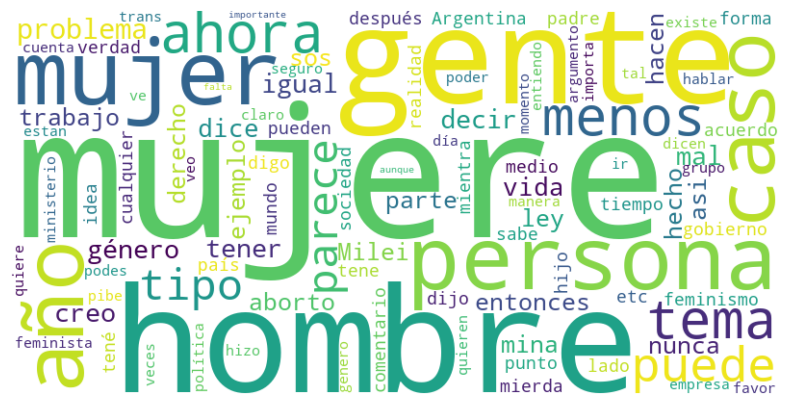

In [47]:
# Generarmos una nube de palabras para los tokens de todos los comentarios
wordcloud = WordCloud(width=800, height=400, max_words=100, background_color='white').generate(' '.join(lista_completa_tokens))

# Visualizamos la nube de palabras
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [48]:
lista_post_id = comentarios["post_id"].unique()
print(lista_post_id)

['1drfn40' 'j0colv' '1dv5f2f' '7i64gs' '1c3vui6' 'lpzh7q' 'a17uhc'
 '18dzrd9' 'wmgi4i' 'f4xflf' '1cxjqa2' 'z38oig' '8p3xwu' '1dis76f'
 'fb2yk2' 'uvwgcg' '181b0sw' '14bwsqn' '1dvmrne' 'jj1v1t' '18lgaj2'
 '15ftl4k' '6bc0hq' 'jv6ubc' 'syslxl' '1bztoof' 'y42f5m' 'lnijdl'
 '16a8bxk' 'w0wpki' 'u4hf3s' '1ali6uf' '13k4g2g' '6fitul' '16tqnqk'
 '6c5p04' 'zat1fy' '17glovh' '6pgibn' 'l8louw' '1c1lwh7' 'ql921q' '5y7ajw'
 '17u97xc' 'xxj06y' 'sy86mr' '16ci2jh' '1b2i0nk' '7eycql' 'utzm5g'
 'a8h0yz' '16qy2cp' '10begvl' 'z7t0kc' '9q9mm0' '183mvvi' 'vgtk58'
 'izu975' 'm4xj52' '62wlrv' '7f3jh4' '6j39lu' '15ii5ew' 'gpd8xm' 'out34w'
 'ssbjil' 'mf5nup' '10rtvy8' '16p9chg' 'mjijgj' 'y5bys5' '145az4m'
 '14fupzf' '7d39g5' 'sgyc63' 'malfqg' '15t1k08' 'y51cc9' '9jw3pz' 'dzhvo1'
 '1c321vo' 'ki5iq8' '1cz8xqr' 'bk9jvy' '1ba50ec' 'ayqae1' '1b9p8hy'
 'sww22s' '5n1gaj' '8cv6py' '17vso9u' 'qea3bn' '67qlke' '85xooy' 'xyyynf'
 'iv8xpp' 'lrc7q8' 'pambn7' 'duxkld' 'tbsj6t' 'v1put9' '183bl7o' '1cz0sck'
 '9v634s' '14mfwng' '1

In [49]:
# Generamos una función para almacenar tokens y títulos únicos para cada valor único en la 'columna_id'.
def almacenar_tokens_titulos_por_post_id(df, columna_id, columna_tokens, columna_title):


    tokens_titulos_por_post_id = {}

    # Obtenemos los valores únicos de la columna de identificación
    valores_unicos = df[columna_id].unique()

    for valor in valores_unicos:
        df_filtrado = df[df[columna_id] == valor]

        # Combinamos todos los tokens en una sola lista
        tokens_combinados = []
        for tokens in df_filtrado[columna_tokens]:
            tokens_combinados.extend(tokens)

        # Obtenemos el título único
        titulo_unico = df_filtrado[columna_title].unique()[0]

        # Almacenamos los tokens combinados y el título único en el diccionario
        tokens_titulos_por_post_id[valor] = {
            'tokens': tokens_combinados,
            'title': titulo_unico
        }

    return tokens_titulos_por_post_id

In [50]:
# Almacenamos los tokens y títulos por post_id
tokens_titulos_por_post_id = almacenar_tokens_titulos_por_post_id(comentarios, 'post_id', 'tokens', 'title')

# Convertimos el diccionario a un DataFrame
df_tokens_titulos_por_post_id = pd.DataFrame([
    {'post_id': post_id, 'title': data['title'], 'tokens': data['tokens']}
    for post_id, data in tokens_titulos_por_post_id.items()
])

In [51]:
df_tokens_titulos_por_post_id

,post_id,title,tokens
0,1drfn40,"Nueva tanda de despidos masivos en el Estado, ...",[]
1,j0colv,Las respuestas del curso de genero “obligatori...,"[Ponganme, movida, profesAlumnos, quedaria, pr..."
2,1dv5f2f,"Cambió de género cuando era menor, se arrepint...","[009, 009, 009, Cambió, género, menor, arrepin..."
3,7i64gs,[Opinión] Violencia de genero,[]
4,1c3vui6,"Leonardo Orlando, profesor argentino censurado...",[]
...,...,...,...
201,hxphkw,Nahir Galarza será representada por una abogad...,"[Reminder, loca, metió, tiros, novio, medio, c..."
202,smmxkf,Idioma guaraní con enfoque de género,"[009, 009, 009, Tribuno, wwweltribunocomjujuyn..."
203,mwaukp,"Nuestra sociedad no es machista ni patriarcal,...","[momento, creí, haber, leído, sociedad, POLENT..."
204,m0l5tz,TN y eltrece tendrán editora de género,"[009, 009, 009, TN, eltrece, editora, género, ..."


### TOKENS MAS COMUNES POR POST

In [52]:
# TOKENS MAS COMUNES POR POST
# Diccionario para almacenar los contadores de tokens por post_id
tokens_sin_nulos = {}

for index, row in df_tokens_titulos_por_post_id.iterrows():
    post_id = row['post_id']
    tokens = row['tokens']
    title = row['title']

    if tokens:  # Omitimos listas vacías
        token_counts = Counter(tokens)
        tokens_sin_nulos[post_id] = {
            'title': title,
            'tokens': dict(token_counts.most_common(15))
        }

# Mostramos los tokens más comunes para cada post_id
for post_id, data in tokens_sin_nulos.items():
    print(f"Post ID '{post_id}':")
    print(f"Title: {data['title']}")
    print("Token Counts:")
    print(data['tokens'])
    print("-" * 40)

Post ID 'j0colv':
Title: Las respuestas del curso de genero “obligatorio” de la UBA
Token Counts:
{'curso': 54, 'obligatorio': 24, 'menos': 22, 'mujeres': 19, 'mal': 19, 'respuestas': 19, 'género': 15, 'UBA': 15, 'cualquier': 15, 'violencia': 15, 'mujer': 14, 'parece': 13, 'decir': 13, 'ciencias': 13, 'leer': 12}
----------------------------------------
Post ID '1dv5f2f':
Title: Cambió de género cuando era menor, se arrepintió y volvió a tramitar el DNI de mujer: culpó a sus padres por haberlo permitido
Token Counts:
{'gente': 78, 'género': 76, 'padres': 75, 'trans': 68, 'años': 58, 'casos': 56, 'vida': 56, 'disforia': 55, 'tema': 47, 'persona': 46, 'cambio': 42, 'edad': 38, 'puede': 38, 'hormonas': 35, 'menos': 35}
----------------------------------------
Post ID 'lpzh7q':
Title: Mientras tanto, el Ministerio de las Mujeres, Géneros y Diversidad está comprando (entre otras cosas) 270 sillas (por aprox. $11.000.000), 40 percheros de pie (por $463.000), 30 percheros de pared (por $760.0

### NUBES DE PALABRAS POR POST

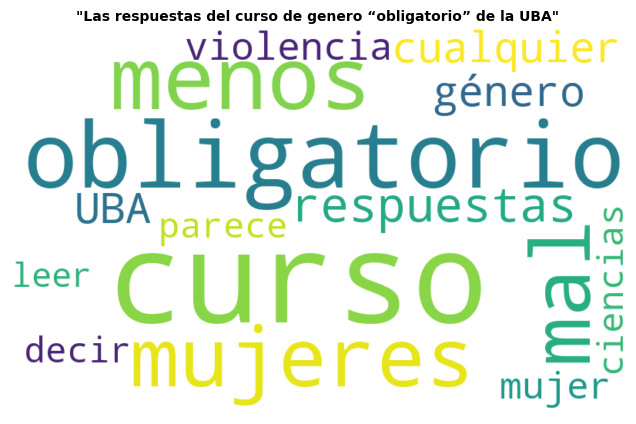

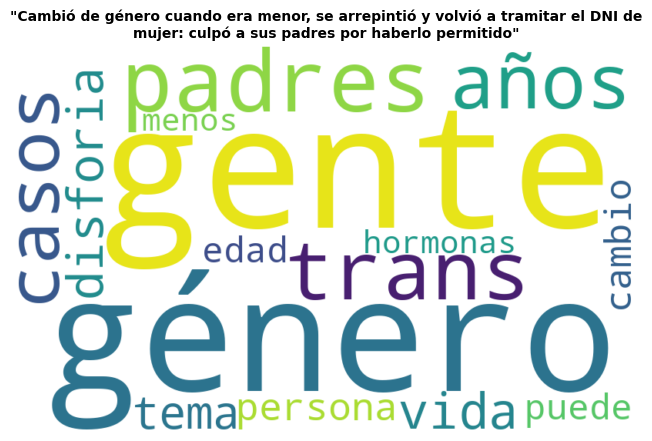

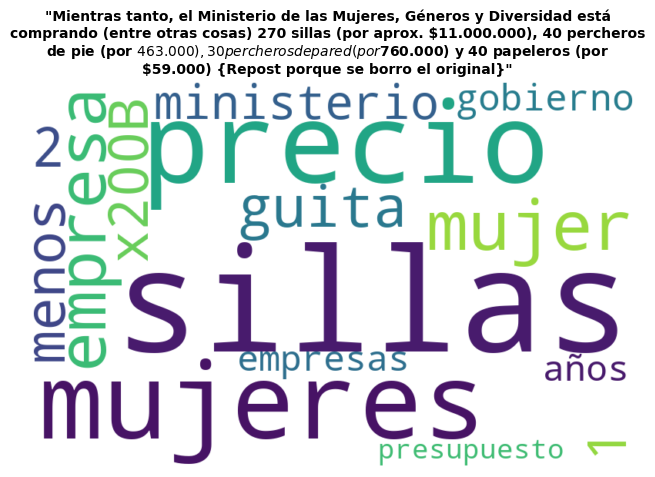

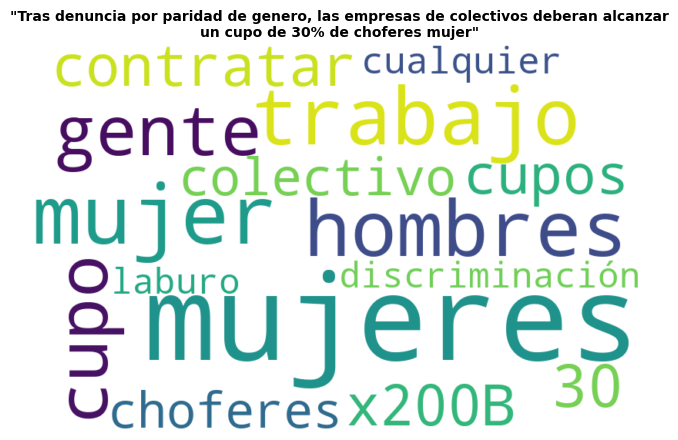

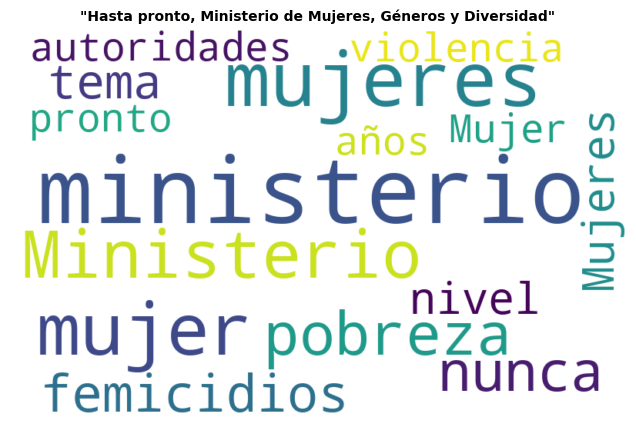

...

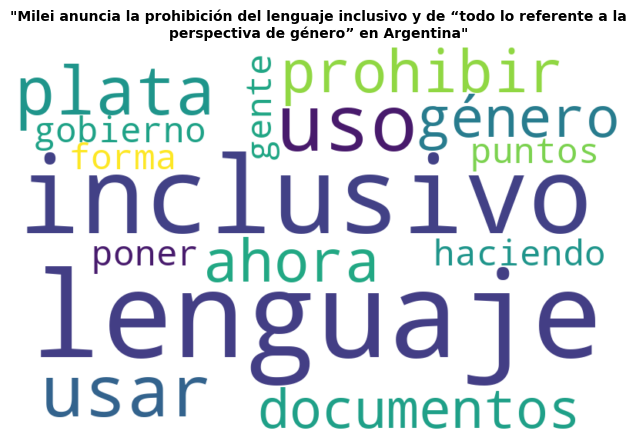

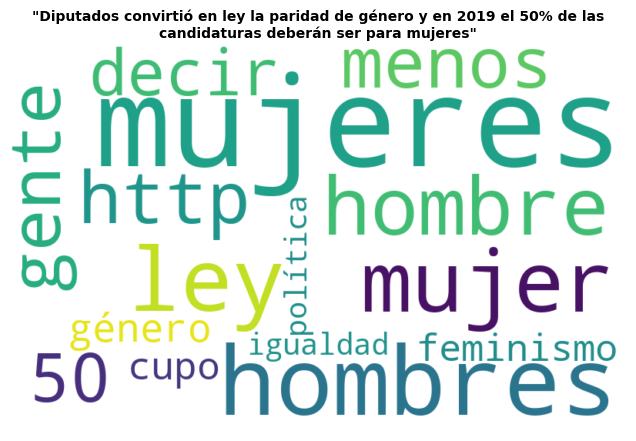

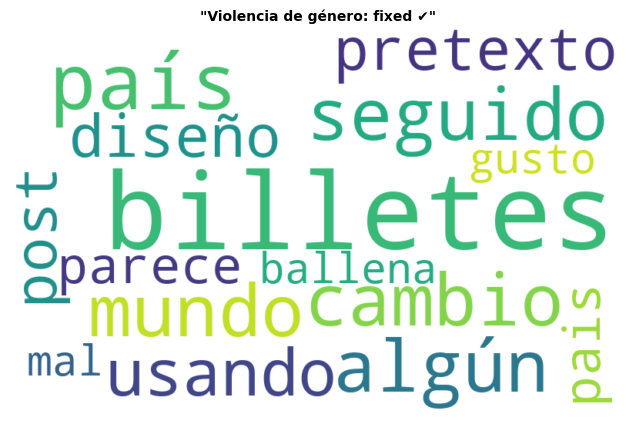

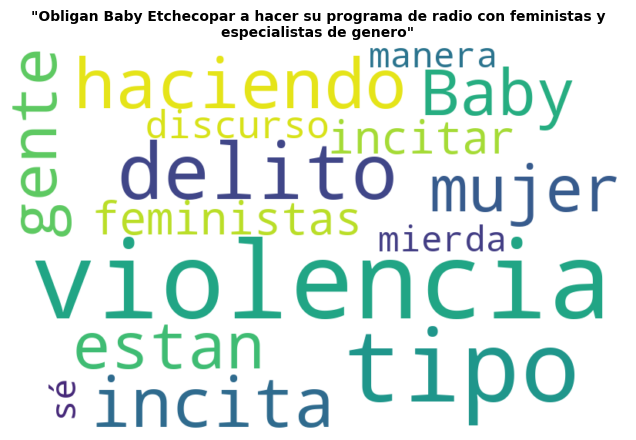

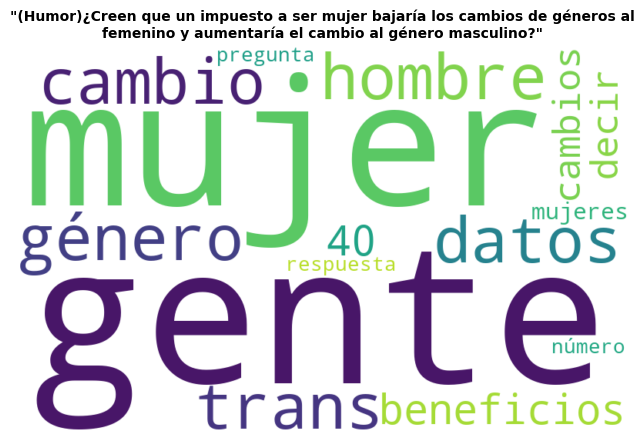

C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 148 (\x94) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


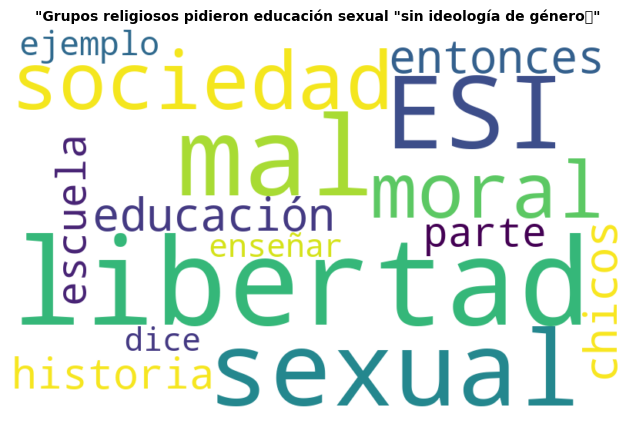

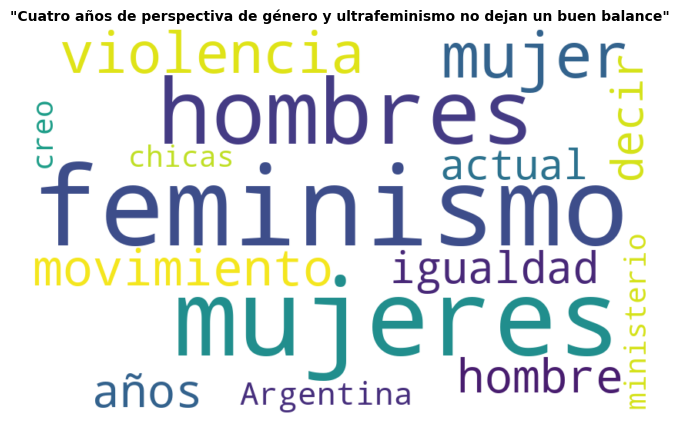

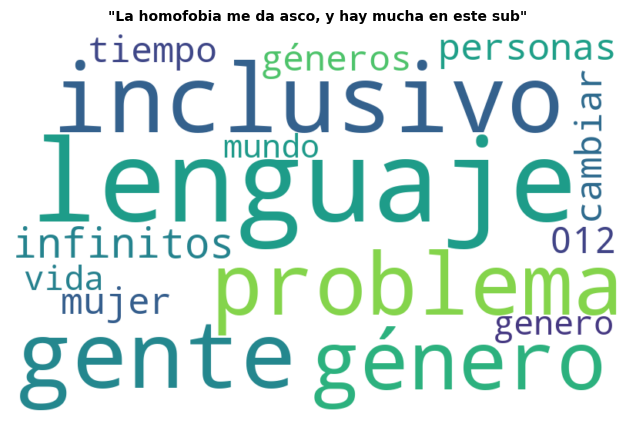

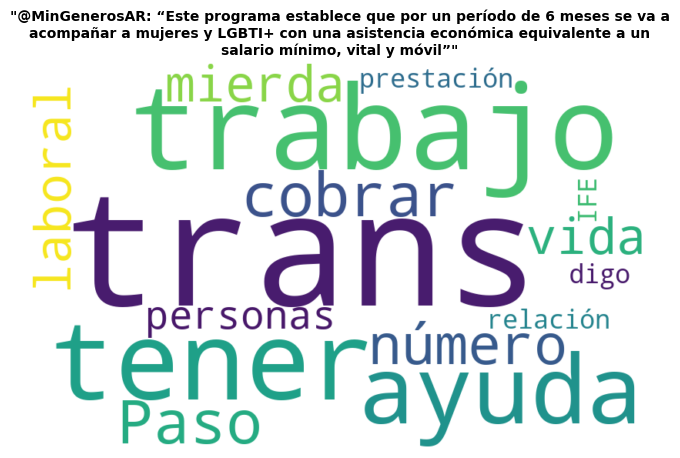

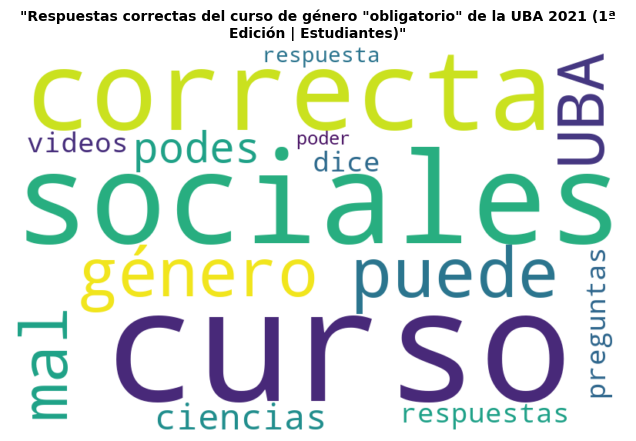

...

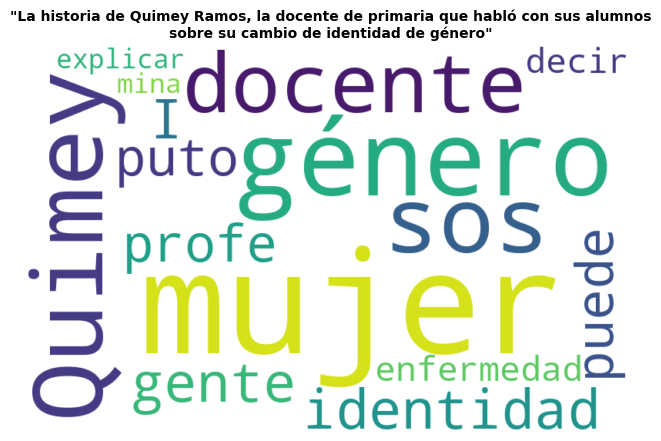

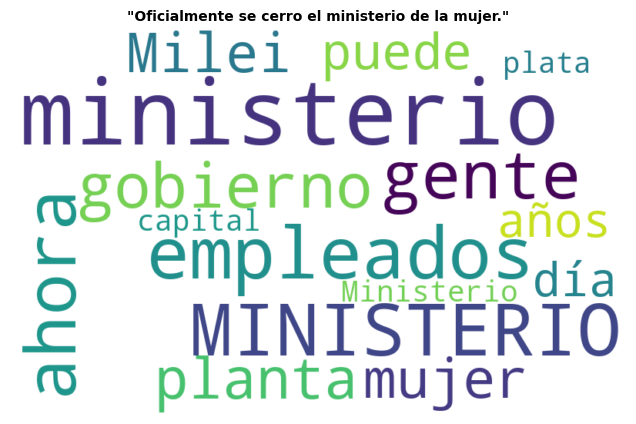

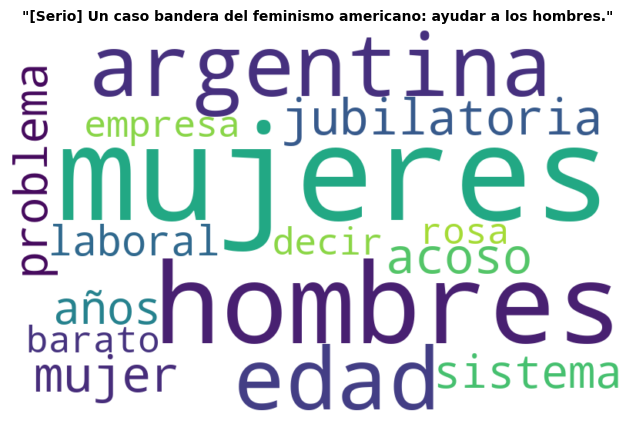

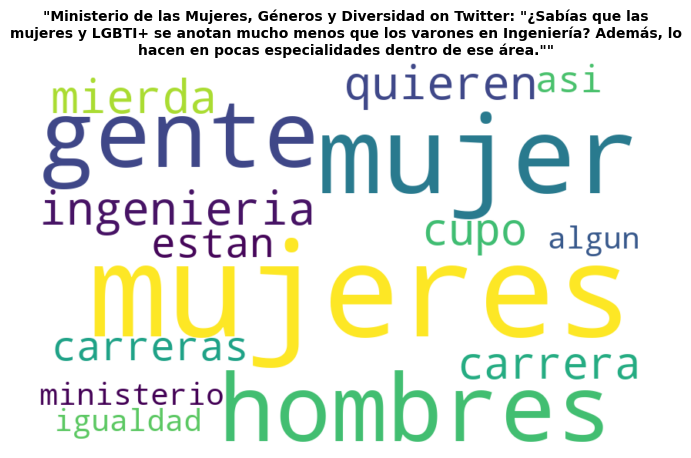

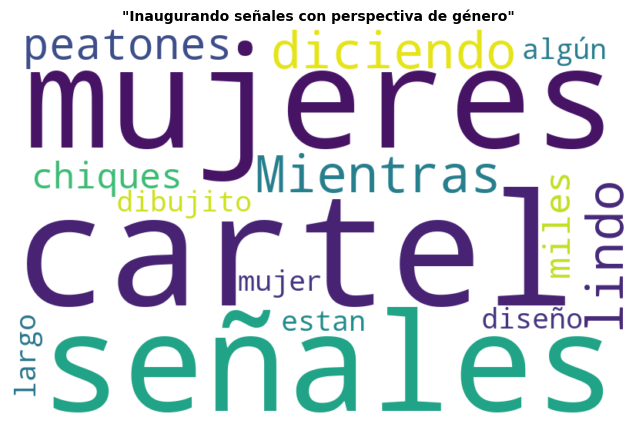

C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128154 (\N{GREEN HEART}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128156 (\N{PURPLE HEART}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


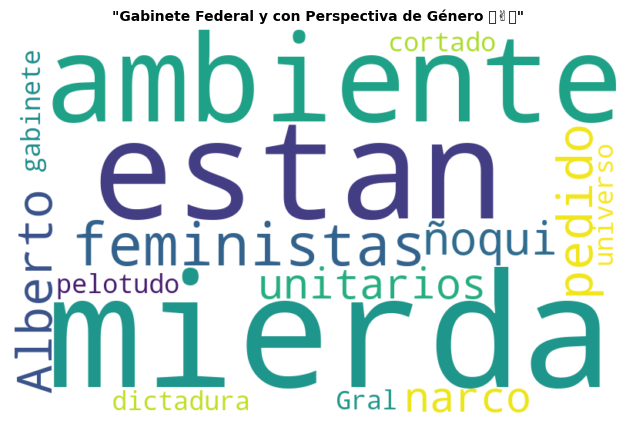

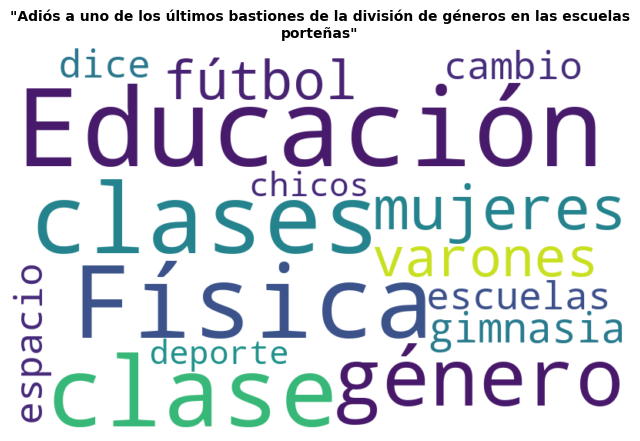

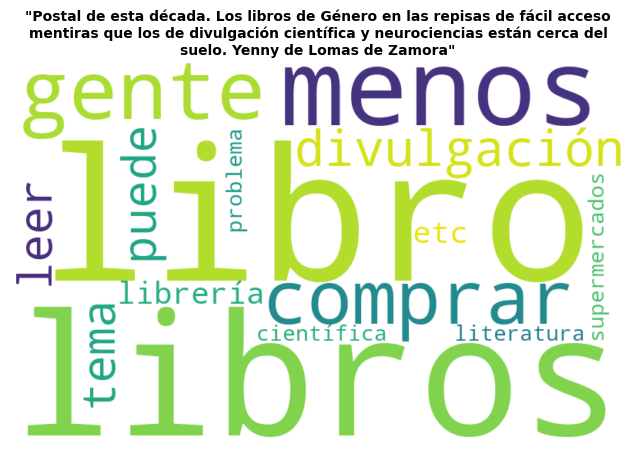

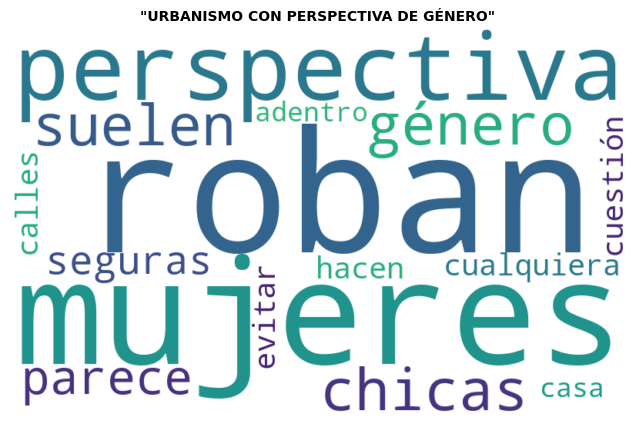

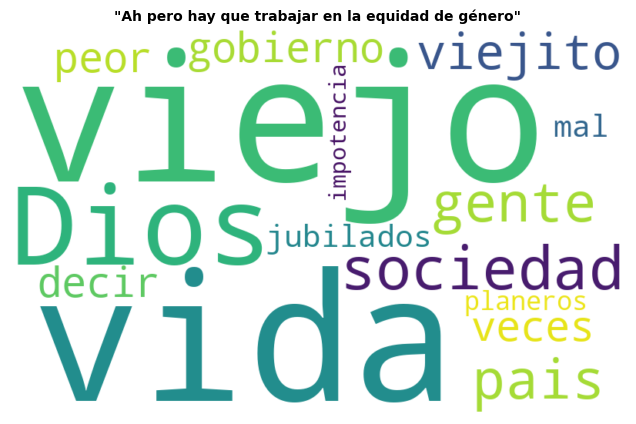

...

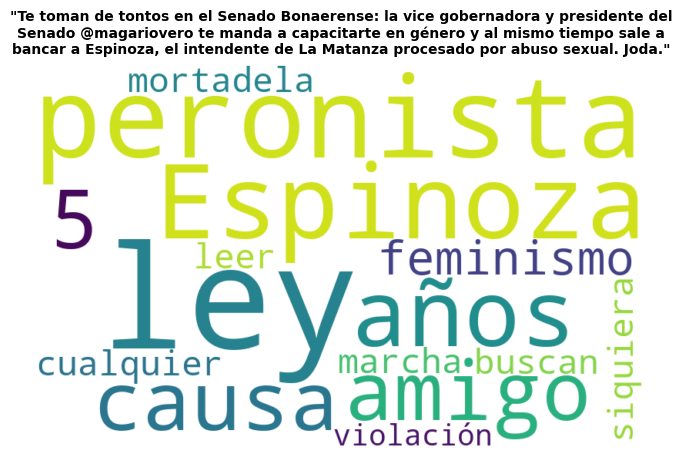

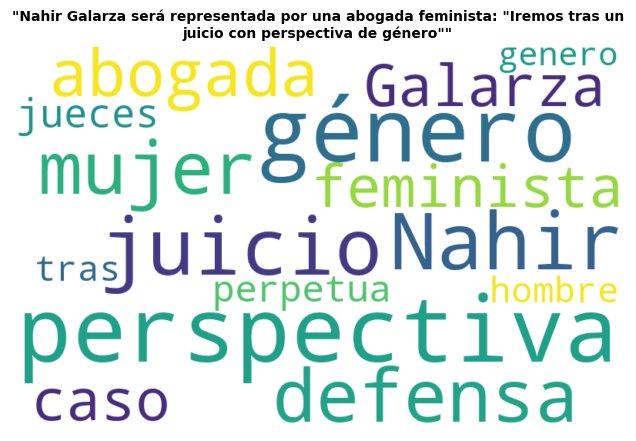

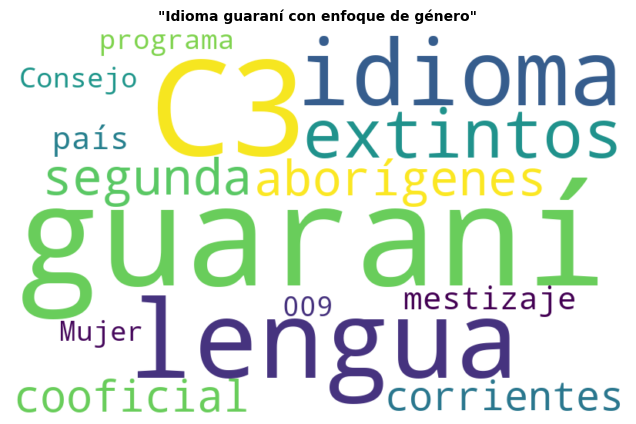

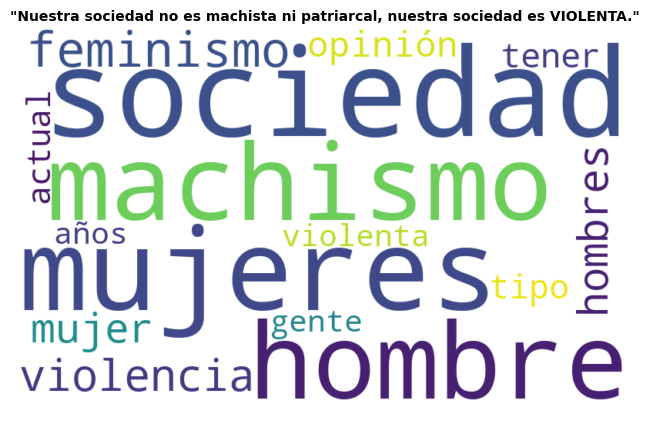

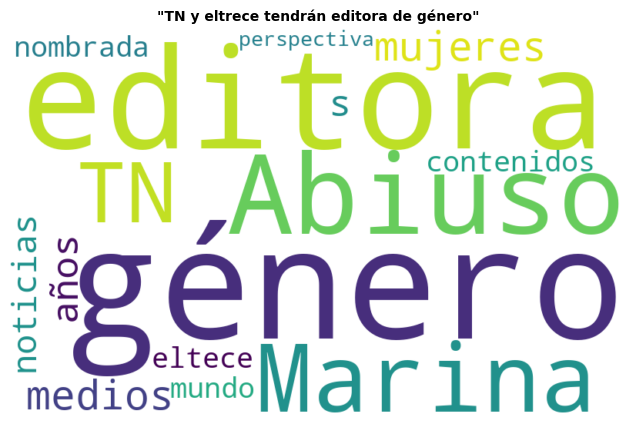

In [53]:
# NUBE DE PALABRAS POR POST
# Iteramos sobre cada post_id en tokens_sin_nulos

for post_id, data in tokens_sin_nulos.items():
    title = data['title']
    token_counts = data['tokens']

    # Creamos una instancia de WordCloud
    wordcloud = WordCloud(width=800, height=500, background_color='white').generate_from_frequencies(token_counts)

    # Ajustamos el título para mostrarlo en múltiples líneas si es necesario
    wrapped_title = '\n'.join(textwrap.wrap(title, width=80))  # Ajustar el ancho máximo según sea necesario

    # Mostramos la nube de palabras
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'"{wrapped_title}"', fontsize=10, fontweight='bold', ha='center')
    plt.show()

### TOKENS MAS COMUNES SEGUN PALABRA EN EL TITULO DEL POST

In [54]:
# TOKENS MAS COMUNES SEGUN PALABRA EN EL TITULO DEL POST
from collections import Counter

def tokens_comunes_por_palabra(df, palabra):
    # Filtramos el DataFrame por títulos que contengan la palabra especificada
    df_filtrado = df[df['title'].str.contains(palabra, case=False, na=False)]

    # Recopilamos todos los tokens de los títulos filtrados en una lista
    tokens_totales = []
    for tokens in df_filtrado['tokens']:
        tokens_totales.extend(tokens)

    # Contamos tokens más comunes entre todos los títulos filtrados
    token_counts = Counter(tokens_totales)
    most_common_tokens = token_counts.most_common(15)  # Obtener los 15 tokens más comunes

    # Mostramos resultados
    print(f"Títulos con la palabra '{palabra}' encontrada:")
    print("Palabras más mencionadas:")
    for token, count in most_common_tokens:
        print(f"{token}: {count}")
    print("-" * 40)

In [55]:
tokens_comunes_por_palabra(df_tokens_titulos_por_post_id, 'género')

Títulos con la palabra 'género' encontrada:
Palabras más mencionadas:
mujeres: 1391
género: 1200
mujer: 1116
gente: 977
puede: 697
años: 670
hombres: 664
hombre: 652
menos: 605
decir: 542
violencia: 541
tener: 496
parece: 491
tipo: 488
mal: 475
----------------------------------------


## CODIGO ENTREGA 4: Bow, Ner, etiquetado con IA

### BOW

In [56]:
!pip install scikit-learn

In [57]:
!pip install spacy
!python -m spacy download en_core_web_sm

     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     ---- ----------------------------------- 1.6/12.8 MB 10.5 MB/s eta 0:00:02
     ------------- -------------------------- 4.2/12.8 MB 10.5 MB/s eta 0:00:01
     ------------------- -------------------- 6.3/12.8 MB 10.7 MB/s eta 0:00:01
     --------------------------- ------------ 8.7/12.8 MB 10.7 MB/s eta 0:00:01
     ------------------------------- -------- 10.0/12.8 MB 9.9 MB/s eta 0:00:01
     ------------------------------------- -- 12.1/12.8 MB 9.9 MB/s eta 0:00:01
     ---------------------------------------- 12.8/12.8 MB 9.6 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [58]:
!pip install spacy
!pip install torch

In [59]:
!pip install -q -U google-generativeai

In [60]:
!pip install tqdm

In [61]:
#Importamos pandas, spacy, matplot y sickit learn con sus módulos correspondientes

import pandas as pd
import spacy
import matplotlib.pyplot as plt

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

import nltk

from nltk.corpus import stopwords
import re

import time
from tqdm import tqdm

In [62]:
nlp = spacy.load('es_core_news_sm')

In [63]:
#Leemos nuestro csv con datos como df

df = pd.read_excel(r'C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_reddit.xlsx')

In [64]:
#Creamos un df que contenga un subset solo con la columna de comentarios
comentarios_df=df[["comment_body"]].dropna(subset=["comment_body"])

In [65]:
#Preprocesamos el texto, lematizamos, quitamos stop words y verficiamos puntuación y espacios en blanco
def preprocess(text):
    doc = nlp(text)
    tokens = [token.lemma_ for token in doc if not token.is_stop and not token.is_punct and not token.is_space]
    return ' '.join(tokens)

In [66]:
#Preprocesamos el texto, lematizamos, quitamos stop words y verficiamos puntuación y espacios en blanco
def preprocess(text):
    if not isinstance(text, str):
        return ""  # Retorna una cadena vacía si no es texto
    doc = nlp(text)
    tokens = [token.lemma_ for token in doc if not token.is_stop and not token.is_punct and not token.is_space]
    return ' '.join(tokens)

# Aplicar la función a la columna asegurándote de manejar valores no válidos
comentarios_df['processed'] = comentarios_df['comment_body'].apply(preprocess)

In [67]:
#Armamos una nueva columna que aplique la función de preprocesamiento 
comentarios_df['processed'] = comentarios_df['comment_body'].apply(preprocess)

In [68]:
print(comentarios_df.head())

                                        comment_body  \
1  Ponganme en la movida: Esto es para profes/Alu...   
2  Gracias a este curso ya no cago a cintazos a m...   
3  Que ganas de cabecear el marco de una puerta q...   
4  Ahora si que el hincha de bokita va a dejar de...   
5                                          [deleted]   

                                           processed  
1  Ponganme movida prof Alumnos quedariar program...  
2  gracias curso caer cintazo novia drogar gracia...  
3                         gana cabecear marco puerta  
4                    hincha bokita dejar fajar jermu  
5                                            deleted  


In [69]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Alessandro\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [70]:
stop_words = list(spacy.lang.es.stop_words.STOP_WORDS)

In [71]:
#Sumamos stop words personalizadas
personalized_stop_words = {"si","ser","cosa","cosas","no","nose","vos","yo","mas","más","hace",
                           "hacer","ver","viste","ven","va","solo","sola","bien","iba","voy",
                           "van","va","cual","tan","da","doy","den","dan","de","ni", "las",
                           "che","Che","https","deleted", "ni","en","la","el","lo","las","les",
                           "este","esta","muy","que","donde","se","y","por","para","a","re",
                           "para","por","contra","desde","removed","si","mucho","muchas","me",
                           "mi","que","acá","como", "cuando","un","una", "uno","tambien",
                           "tampoco","esta","nos","todos","todas","te","mucho","mucha","muchos",
                           "pasa","siempre","nadie","bueno","mejor","sino","alguien","cómo",
                           "dos","cada","ahí","así","vas","vez","q","entones","misma","mismo"}
stop_words.extend(personalized_stop_words)


In [72]:
#Convertimos el texto en una matriz de bag of words, contamos los términos con el vectorizador, eliminamos palabras con demasiada frecuencia, palabras raras y stopwords
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words=stop_words)
X = vectorizer.fit_transform(comentarios_df['processed'])

In [73]:
#Implementamos y fiteamos lda con 15 componentes o tópicos
lda = LatentDirichletAllocation(n_components=15, random_state=42)
lda.fit(X)

LatentDirichletAllocation(n_components=15, random_state=42)

In [74]:
#Generamos una función para iterar cada tema en el modelo LDA, ordenar palabrar por relevancia, seleccionar e imprimir las principales palabras por tópico

def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % (topic_idx))
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

In [75]:
#Aplicamos la función
no_top_words = 20
display_topics(lda, vectorizer.get_feature_names_out(), no_top_words)

Topic 0:
vida leer gente año tipo pasar mierda padre caso hijo hablar terminar madre serio llegar mina familia tomar entender persona
Topic 1:
mujer hablar gente tipo año querer llegar gobierno mundo entender buscar clase vivir posta argentina pelotudo cupo trabajo puta tema
Topic 2:
the of and to www in this is that gender com estudio for you org http post gov are belleza
Topic 3:
mujer aborto ley femicidio ministerio año legal negro gasto matar calle pasar sacar problema pobreza violencia seguir situación pensar 10
Topic 4:
pasar tipo mina violencia denuncia mujer año dejar salir casa querer cagar caso falso hombre policía amigo denunciar meter viejo
Topic 5:
mujer hablar persona pagar aborto problema ah pasar vida seguro plata año ley tema gobierno tén gente eh vo laburar
Topic 6:
mujer com género hombre trabajo www violencia varón ministerio trabajar ley puesto brecha justicia falso argentina jpg ciento sector sociedad
Topic 7:
punto entender pagar salir querer vo gastar humano vid

Repetimos los pasos sobre los títulos en vez de los comentarios

In [76]:
titulo_df=df[["title"]].dropna(subset=["title"])

In [77]:
def preprocess(text):
    doc = nlp(text)
    tokens = [token.lemma_ for token in doc if not token.is_stop and not token.is_punct and not token.is_space]
    return ' '.join(tokens)

In [78]:
titulo_df['processed'] = titulo_df['title'].apply(preprocess)


In [79]:
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words=stop_words)
X = vectorizer.fit_transform(titulo_df['processed'])

In [80]:
lda = LatentDirichletAllocation(n_components=15, random_state=42)
lda.fit(X)

LatentDirichletAllocation(n_components=15, random_state=42)

In [81]:
def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % (topic_idx))
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

In [82]:
no_top_words = 20
display_topics(lda, vectorizer.get_feature_names_out(), no_top_words)

Topic 0:
género violencia paridad cambio genero mujer sacar registro patriarcado femicidio curso resolución cobertura gratuito integral rubinstein tratamiento denuncia empresa colectivo
Topic 1:
género mujer volver dni menor tramitar arrepinteír permitir culpó padre cambió violencia perspectiva cambiar año desigualdad reclamar cifra cuotas desastre
Topic 2:
mujeres perchero 40 géneros diversidad ministerio 30 comprar 463000 papelero pie 270 pared silla 11000000 original aprox borro repost 760000
Topic 3:
género facultad uba violencia diversidad pensamiento ideología promovemos delirio etchecopar imputar discriminación baby 2021 correcto 1ª edición respuestas estudiantes obligatorio
Topic 4:
milei cambio feminismo destacado crítica internacional frase desmentida climático discurso género serio jubilación acerca consulta identidad científico ideología acceso mentira
Topic 5:
ministerio mujer político milei problema cierre frente diputada atravesar plá solución izquierda propuesta real ni

### NER

In [20]:
#Leemos nuestro csv como df

df = pd.read_excel(r'C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_reddit.xlsx')

In [84]:
#Creamos un subset con las columnas seleccionamos y eliminamos los NAN
comentarios_df = df[['title', 'comment_body', "time_created"]].dropna(subset=['comment_body'])


In [85]:
#Eliminamos NAN de time creates
comentarios_df = comentarios_df.dropna(subset=['time_created'])

In [86]:
#Convertimos a formato datetime
comentarios_df['time_created'] = pd.to_datetime(comentarios_df['time_created'], errors='coerce')

In [87]:
#Filtramos por año
comentarios_df['year'] = comentarios_df['time_created'].dt.year

In [88]:
comentarios_df['comment_body'] = comentarios_df['comment_body'].astype(str)

#Armamos una nueva columna que aplique la función de preprocesamiento 
comentarios_df['processed'] = comentarios_df['comment_body'].apply(preprocess)

In [89]:
# Función corregida para evitar valores que no son cadena
def contiene_milei(text):
    if not isinstance(text, str):
        return False  # Devuelve False si no es texto
    doc = nlp(text)
    return any(ent.text.lower() == "milei" for ent in doc.ents)

In [90]:
#Generamos una nueva columna a la que sobre la columna de comentarios aplicamos nuestra función
comentarios_df['contiene_milei'] = comentarios_df['comment_body'].apply(contiene_milei)

In [91]:
comentarios_df

,title,comment_body,time_created,year,processed,contiene_milei
1,Las respuestas del curso de genero “obligatori...,Ponganme en la movida: Esto es para profes/Alu...,2020-09-26,2020,Ponganme movida prof Alumnos quedariar program...,False
2,Las respuestas del curso de genero “obligatori...,Gracias a este curso ya no cago a cintazos a m...,2020-09-26,2020,gracias curso caer cintazo novia drogar gracia...,False
3,Las respuestas del curso de genero “obligatori...,Que ganas de cabecear el marco de una puerta q...,2020-09-26,2020,gana cabecear marco puerta,False
4,Las respuestas del curso de genero “obligatori...,Ahora si que el hincha de bokita va a dejar de...,2020-09-26,2020,hincha bokita dejar fajar jermu,False
5,Las respuestas del curso de genero “obligatori...,[deleted],2020-09-26,2020,deleted,False
...,...,...,...,...,...,...
20554,TN y eltrece tendrán editora de género,"Me parece que sí es la discusión de fondo, por...",2021-03-08,2021,discusión fondo comentario sub tipo posteo dar...,False
20555,TN y eltrece tendrán editora de género,"No lo creo. Esa ""mayoría"" es cada vez menor.",2021-03-08,2021,mayoría menor,False
20556,TN y eltrece tendrán editora de género,"Si, o sea por ejemplo puedo ejercer como elect...",2021-03-08,2021,ejemplo ejercer electricista matriculado plome...,False
20557,TN y eltrece tendrán editora de género,Me explicas cumatas mujeres dejan de subir aco...,2021-03-08,2021,explica cumata mujer dejar subir acoso laboral...,False


In [92]:
milei_df = comentarios_df[comentarios_df['contiene_milei']]

In [93]:
#Filtramos por año
milei_evolucion = milei_df.groupby('year').size().reset_index(name='count')

In [94]:
print(milei_evolucion)

   year  count
0  2019      1
1  2022     70
2  2023     76
3  2024    195


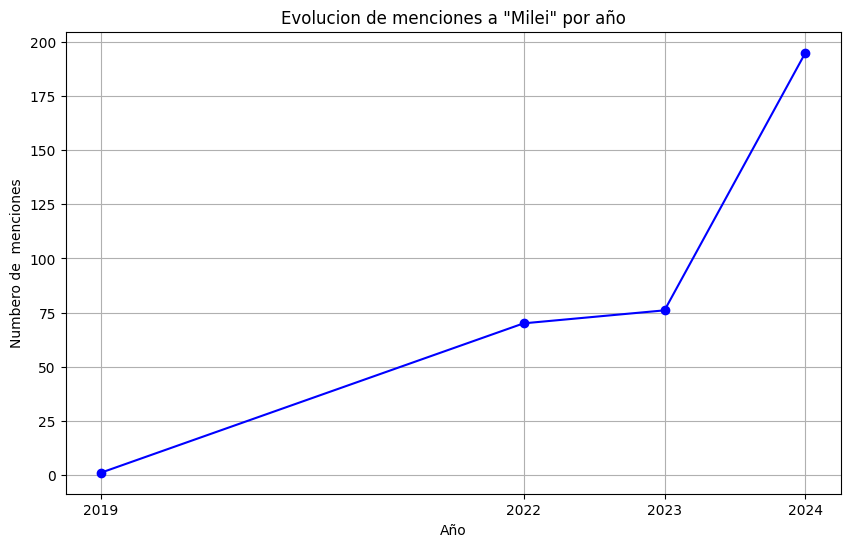

In [95]:
#Graficamos con matplotlib

plt.figure(figsize=(10, 6))
plt.plot(milei_evolucion['year'], milei_evolucion['count'], marker='o', linestyle='-', color='blue')
plt.xticks(milei_evolucion['year'])  
plt.xlabel('Año')
plt.ylabel('Numbero de  menciones')
plt.title('Evolucion de menciones a "Milei" por año')
plt.grid(True)

Replicamos el proceso pero en los títulos y con el término "Ministerio de la mujer"

In [96]:
#Creamos un subset con las columnas seleccionamos y eliminamos los NAN
titulos_df = df[['title', "time_created"]].dropna(subset=['title'])

In [97]:
#Eliminamos NAN de time creates
titulos_df = titulos_df.dropna(subset=['time_created'])

In [98]:
#Convertimos a formato datetime
titulos_df['time_created'] = pd.to_datetime(titulos_df['time_created'], errors='coerce')

In [99]:
#Filtramos por año
titulos_df['year'] = titulos_df['time_created'].dt.year

In [100]:
#Armamos una nueva columna que aplique la función de preprocesamiento 
titulos_df['processed'] = titulos_df['title'].apply(preprocess)

In [101]:
def contains_ministerio(text):
    doc = nlp(text)
    return any(ent.text.lower() == "ministerio de la mujer" for ent in doc.ents)

In [102]:
titulo_df['contains_ministerio'] = titulo_df['title'].apply(contains_ministerio)

In [103]:
minsiterio_df = titulos_df[titulo_df['contains_ministerio']]

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_8116\672993768.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  minsiterio_df = titulos_df[titulo_df['contains_ministerio']]


In [104]:
ministerio_evolucion = minsiterio_df.groupby('year').size().reset_index(name='count')

In [105]:
print(ministerio_evolucion)

   year  count
0  2023    257


Replicamos el proceso en los comentarios con el término "IDEOLOGÍA DE GÉNERO"

In [106]:
def contiene_ideologia(text):
    if not isinstance(text, str):
        return False
    doc = nlp(text)
    return any(ent.text.lower() == "ideologia de genero" for ent in doc.ents)

In [107]:
comentarios_df['contiene_ideologia'] = comentarios_df['comment_body'].apply(contiene_ideologia)

In [108]:
ideolgia_evolucion = comentarios_df.groupby('year').size().reset_index(name='count')

In [109]:
print(ideolgia_evolucion)

   year  count
0  2017   2440
1  2018   1888
2  2019   1261
3  2020   2640
4  2021   2901
5  2022   3102
6  2023   2452
7  2024   3823


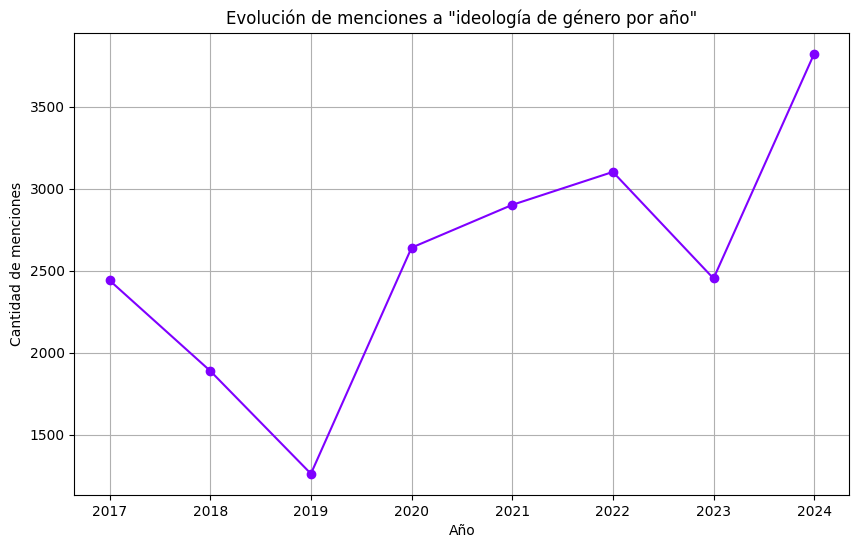

In [110]:
plt.figure(figsize=(10, 6))
plt.plot(ideolgia_evolucion['year'], ideolgia_evolucion['count'], marker='o', linestyle='-', color='#7f00ff')
plt.xticks(ideolgia_evolucion['year']) 
plt.xlabel('Año')
plt.ylabel('Cantidad de menciones')
plt.title('Evolución de menciones a "ideología de género por año"')
plt.grid(True)

### VALORACION CON PYSENTIMIENTO

In [111]:
!pip install pysentimiento

In [7]:
from pysentimiento import create_analyzer
analyzer = create_analyzer(task="sentiment", lang="es")

analyzer.predict("Qué gran jugador es Messi")

C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


AnalyzerOutput(output=POS, probas={POS: 0.946, NEU: 0.037, NEG: 0.017})

In [113]:
analyzer.predict("Esto es pésimo")

AnalyzerOutput(output=NEG, probas={NEG: 0.887, NEU: 0.098, POS: 0.014})

In [114]:
analyzer.predict("Qué es esto?")

AnalyzerOutput(output=NEU, probas={NEU: 0.548, NEG: 0.412, POS: 0.041})

In [115]:
from pysentimiento import create_analyzer

analyzer = create_analyzer(task="sentiment", lang="es")

# Creamos un subset con las columnas seleccionadas y eliminamos los NAN
comentarios_valoracion = df[['title', 'comment_body', "time_created"]].dropna(subset=['comment_body'])
comentarios_valoracion = comentarios_valoracion.dropna(subset=['time_created'])

In [116]:
# Convertimos 'time_created' a formato datetime
comentarios_valoracion['time_created'] = pd.to_datetime(comentarios_valoracion['time_created'], errors='coerce')

# Filtramos por año
comentarios_valoracion['year'] = comentarios_valoracion['time_created'].dt.year

In [117]:
# Convertimos la columna 'comment_body' a cadenas
comentarios_valoracion['comment_body'] = comentarios_valoracion['comment_body'].astype(str)

In [118]:
# Etiquetamos los comentarios según su valoración
comentarios_valoracion['sentiment'] = comentarios_valoracion['comment_body'].apply(
    lambda x: analyzer.predict(x).output)

In [119]:
comentarios_valoracion

,title,comment_body,time_created,year,sentiment
1,Las respuestas del curso de genero “obligatori...,Ponganme en la movida: Esto es para profes/Alu...,2020-09-26,2020,NEU
2,Las respuestas del curso de genero “obligatori...,Gracias a este curso ya no cago a cintazos a m...,2020-09-26,2020,POS
3,Las respuestas del curso de genero “obligatori...,Que ganas de cabecear el marco de una puerta q...,2020-09-26,2020,NEG
4,Las respuestas del curso de genero “obligatori...,Ahora si que el hincha de bokita va a dejar de...,2020-09-26,2020,NEG
5,Las respuestas del curso de genero “obligatori...,[deleted],2020-09-26,2020,NEU
...,...,...,...,...,...
20554,TN y eltrece tendrán editora de género,"Me parece que sí es la discusión de fondo, por...",2021-03-08,2021,NEG
20555,TN y eltrece tendrán editora de género,"No lo creo. Esa ""mayoría"" es cada vez menor.",2021-03-08,2021,NEG
20556,TN y eltrece tendrán editora de género,"Si, o sea por ejemplo puedo ejercer como elect...",2021-03-08,2021,NEU
20557,TN y eltrece tendrán editora de género,Me explicas cumatas mujeres dejan de subir aco...,2021-03-08,2021,NEG


In [9]:
# Agrupamos por año y sentimiento, y contamos las ocurrencias
# Usamos unstack para transformar las categorías de "sentiment" en columnas
comentarios_valoracion_ev = comentarios_valoracion.groupby(['year', 'sentiment']).size().unstack()

comentarios_valoracion_ev

sentiment,NEG,NEU,POS
year,,,
2017,1274,1036,130
2018,1015,796,77
2019,717,491,53
2020,1473,1004,163
2021,1568,1162,171
2022,1689,1224,189
2023,1431,890,131
2024,2430,1219,174


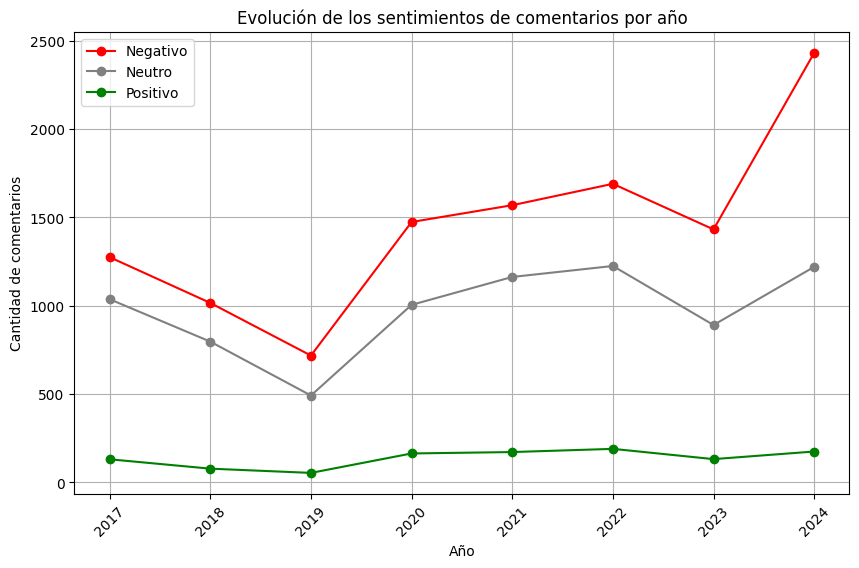

In [10]:
# Configuramos el tamaño del gráfico
plt.figure(figsize=(10, 6))

# Graficamos cada columna (sentimientos) en el DataFrame
plt.plot(comentarios_valoracion_ev.index, comentarios_valoracion_ev['NEG'], marker='o', linestyle='-', color='red', label='Negativo')
plt.plot(comentarios_valoracion_ev.index, comentarios_valoracion_ev['NEU'], marker='o', linestyle='-', color='gray', label='Neutro')
plt.plot(comentarios_valoracion_ev.index, comentarios_valoracion_ev['POS'], marker='o', linestyle='-', color='green', label='Positivo')

# Configuramos las etiquetas del eje X
plt.xticks(comentarios_valoracion_ev.index, rotation=45)
plt.xlabel('Año')
plt.ylabel('Cantidad de comentarios')
plt.title('Evolución de los sentimientos de comentarios por año')
plt.legend()
plt.grid(True)

# Mostramos el gráfico
plt.show()

In [122]:
# Obtener las probabilidades
comentarios_valoracion['sentiment_probs'] = comentarios_valoracion['comment_body'].apply(
    lambda x: {k: round(v, 3) for k, v in analyzer.predict(x).probas.items()})

In [123]:
comentarios_valoracion

,title,comment_body,time_created,year,sentiment,sentiment_probs
1,Las respuestas del curso de genero “obligatori...,Ponganme en la movida: Esto es para profes/Alu...,2020-09-26,2020,NEU,"{'NEG': 0.183, 'NEU': 0.807, 'POS': 0.01}"
2,Las respuestas del curso de genero “obligatori...,Gracias a este curso ya no cago a cintazos a m...,2020-09-26,2020,POS,"{'NEG': 0.032, 'NEU': 0.158, 'POS': 0.81}"
3,Las respuestas del curso de genero “obligatori...,Que ganas de cabecear el marco de una puerta q...,2020-09-26,2020,NEG,"{'NEG': 0.968, 'NEU': 0.021, 'POS': 0.011}"
4,Las respuestas del curso de genero “obligatori...,Ahora si que el hincha de bokita va a dejar de...,2020-09-26,2020,NEG,"{'NEG': 0.746, 'NEU': 0.212, 'POS': 0.042}"
5,Las respuestas del curso de genero “obligatori...,[deleted],2020-09-26,2020,NEU,"{'NEG': 0.289, 'NEU': 0.615, 'POS': 0.095}"
...,...,...,...,...,...,...
20554,TN y eltrece tendrán editora de género,"Me parece que sí es la discusión de fondo, por...",2021-03-08,2021,NEG,"{'NEG': 0.97, 'NEU': 0.025, 'POS': 0.005}"
20555,TN y eltrece tendrán editora de género,"No lo creo. Esa ""mayoría"" es cada vez menor.",2021-03-08,2021,NEG,"{'NEG': 0.847, 'NEU': 0.139, 'POS': 0.015}"
20556,TN y eltrece tendrán editora de género,"Si, o sea por ejemplo puedo ejercer como elect...",2021-03-08,2021,NEU,"{'NEG': 0.041, 'NEU': 0.886, 'POS': 0.073}"
20557,TN y eltrece tendrán editora de género,Me explicas cumatas mujeres dejan de subir aco...,2021-03-08,2021,NEG,"{'NEG': 0.935, 'NEU': 0.062, 'POS': 0.003}"


In [124]:
# Exportamos el resultado
comentarios_valoracion.to_excel('comentarios_valoracion.xlsx', index=False)

In [13]:
comentarios_valoracion_ev

sentiment,NEG,NEU,POS
year,,,
2017,1274,1036,130
2018,1015,796,77
2019,717,491,53
2020,1473,1004,163
2021,1568,1162,171
2022,1689,1224,189
2023,1431,890,131
2024,2430,1219,174


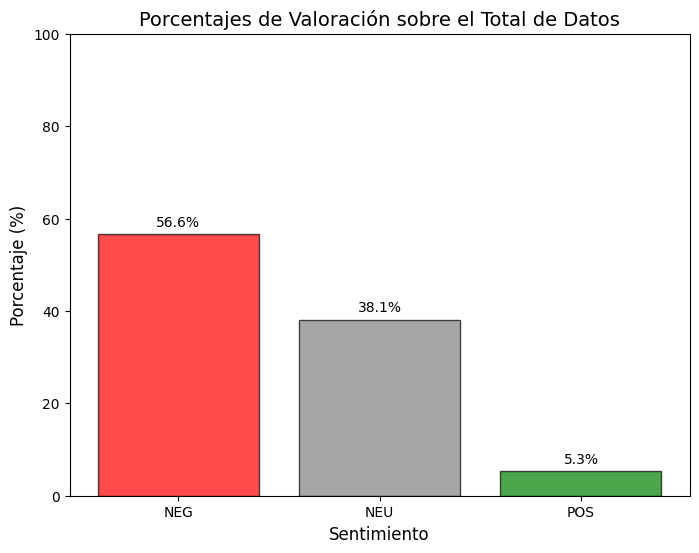

In [11]:
# Calcular los porcentajes de valoración, a total y por año

# Sumamos los totales de cada etiqueta
totales = comentarios_valoracion_ev.sum()

# Calculamos el porcentaje de cada etiqueta sobre el total
porcentajes = (totales / totales.sum()) * 100

# Creamos el gráfico de barras
plt.figure(figsize=(8, 6))
bars = plt.bar(
    porcentajes.index, 
    porcentajes.values, 
    color=['red', 'gray', 'green'], 
    alpha=0.7, 
    edgecolor='black',  
    width=0.8        
)

# Añadimos los porcentajes por encima de las barras
for bar, porcentaje in zip(bars, porcentajes.values):
    plt.text(
        bar.get_x() + bar.get_width() / 2,  
        bar.get_height() + 1,          
        f'{porcentaje:.1f}%',          
        ha='center',                    
        va='bottom',                   
        fontsize=10     
    )

# Configuración del gráfico
plt.xlabel('Sentimiento', fontsize=12)
plt.ylabel('Porcentaje (%)', fontsize=12)
plt.title('Porcentajes de Valoración sobre el Total de Datos', fontsize=14)
plt.ylim(0, 100) 
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Quitamos las líneas horizontales del fondo
plt.grid(False)

# Mostrar el gráfico
plt.show()


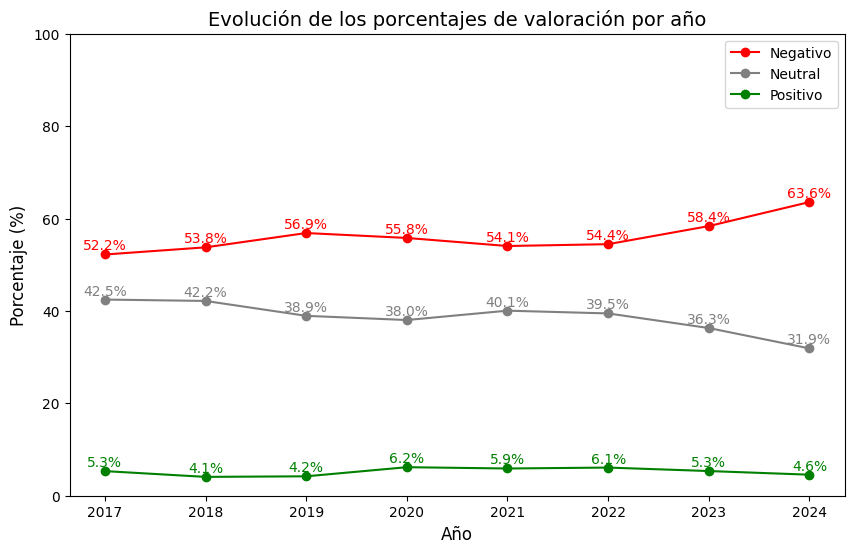

In [16]:
# Configuramos el tamaño del gráfico
plt.figure(figsize=(10, 6))

# Graficamos cada etiqueta y mostramos los valores sobre cada punto
for sentiment, color, label in zip(['NEG', 'NEU', 'POS'], ['red', 'gray', 'green'], ['Negativo', 'Neutral', 'Positivo']):
    plt.plot(
        porcentajes_anuales.index, 
        porcentajes_anuales[sentiment], 
        marker='o', 
        linestyle='-', 
        color=color, 
        label=label
    )
    # Agregar los valores porcentuales sobre cada punto
    for x, y in zip(porcentajes_anuales.index, porcentajes_anuales[sentiment]):
        plt.text(x, y + 1, f'{y:.1f}%', ha='center', fontsize=10, color=color)

# Configuración de los ejes y el gráfico
plt.xlabel('Año', fontsize=12)
plt.ylabel('Porcentaje (%)', fontsize=12)
plt.title('Evolución de los porcentajes de valoración por año', fontsize=14)
plt.ylim(0, 100)  # Porcentajes entre 0 y 100
plt.xticks(porcentajes_anuales.index, fontsize=10)
plt.yticks(fontsize=10)
plt.legend(fontsize=10)

# Eliminar las líneas horizontales del fondo
plt.grid(False)

# Mostrar el gráfico
plt.show()



### Prueba con el analizador de emociones

In [21]:
from pysentimiento import create_analyzer

# Crear el analizador de emociones
analyzer = create_analyzer(task="emotion", lang="es")

# Creamos un subset con las columnas seleccionadas y eliminamos los NaN
comentarios_emocion = df[['title', 'comment_body', "time_created"]].dropna(subset=['comment_body'])
comentarios_emocion = comentarios_emocion.dropna(subset=['time_created'])
# Convertimos 'time_created' a formato datetime
comentarios_emocion['time_created'] = pd.to_datetime(comentarios_emocion['time_created'], errors='coerce')

# Filtramos por año
comentarios_emocion['year'] = comentarios_emocion['time_created'].dt.year
# Convertimos la columna 'comment_body' a cadenas
comentarios_emocion['comment_body'] = comentarios_emocion['comment_body'].astype(str)

# Etiquetamos los comentarios según su emoción dominante
comentarios_emocion['emotion'] = comentarios_emocion['comment_body'].apply(
    lambda x: analyzer.predict(x).output
)

In [22]:
comentarios_emocion

,title,comment_body,time_created,year,emotion
1,Las respuestas del curso de genero “obligatori...,Ponganme en la movida: Esto es para profes/Alu...,2020-09-26,2020,others
2,Las respuestas del curso de genero “obligatori...,Gracias a este curso ya no cago a cintazos a m...,2020-09-26,2020,joy
3,Las respuestas del curso de genero “obligatori...,Que ganas de cabecear el marco de una puerta q...,2020-09-26,2020,fear
4,Las respuestas del curso de genero “obligatori...,Ahora si que el hincha de bokita va a dejar de...,2020-09-26,2020,others
5,Las respuestas del curso de genero “obligatori...,[deleted],2020-09-26,2020,others
...,...,...,...,...,...
20554,TN y eltrece tendrán editora de género,"Me parece que sí es la discusión de fondo, por...",2021-03-08,2021,anger
20555,TN y eltrece tendrán editora de género,"No lo creo. Esa ""mayoría"" es cada vez menor.",2021-03-08,2021,others
20556,TN y eltrece tendrán editora de género,"Si, o sea por ejemplo puedo ejercer como elect...",2021-03-08,2021,others
20557,TN y eltrece tendrán editora de género,Me explicas cumatas mujeres dejan de subir aco...,2021-03-08,2021,anger


In [23]:
# Agrupamos por año y sentimiento, y contamos las ocurrencias
# Usamos unstack para transformar las categorías de "emotion" en columnas
comentarios_emocion_ev = comentarios_emocion.groupby(['year', 'emotion']).size().unstack()

comentarios_emocion_ev

emotion,anger,disgust,fear,joy,others,sadness,surprise
year,,,,,,,
2017,722,5,10,49,1593,35,26
2018,534,1,8,35,1267,29,14
2019,405,1,4,23,801,20,7
2020,854,6,3,69,1626,49,33
2021,901,11,6,85,1813,55,30
2022,875,6,8,102,1999,74,38
2023,785,4,9,86,1484,47,37
2024,1357,6,6,79,2270,71,34


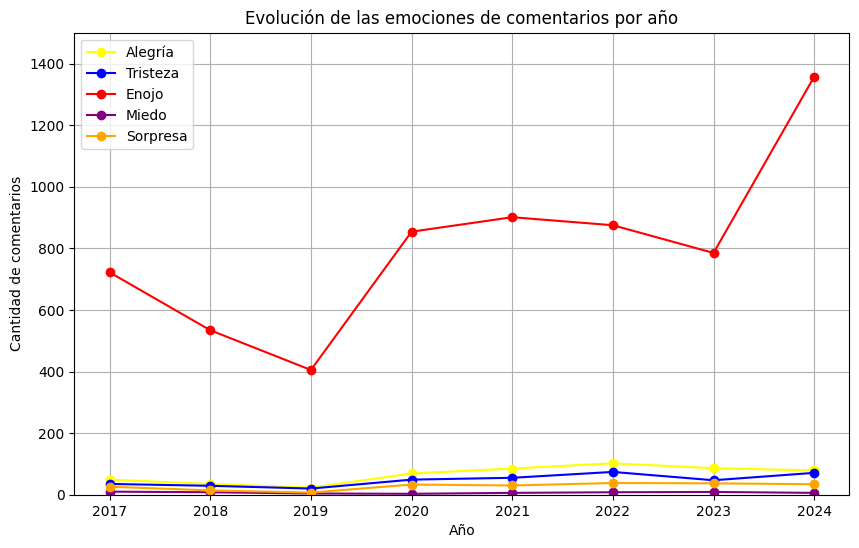

In [24]:
# Configuramos el tamaño del gráfico
plt.figure(figsize=(10, 6))

# Graficar cada emoción detectada
if 'joy' in comentarios_emocion_ev.columns:
    plt.plot(comentarios_emocion_ev.index, comentarios_emocion_ev['joy'], marker='o', linestyle='-', color='yellow', label='Alegría')
if 'sadness' in comentarios_emocion_ev.columns:
    plt.plot(comentarios_emocion_ev.index, comentarios_emocion_ev['sadness'], marker='o', linestyle='-', color='blue', label='Tristeza')
if 'anger' in comentarios_emocion_ev.columns:
    plt.plot(comentarios_emocion_ev.index, comentarios_emocion_ev['anger'], marker='o', linestyle='-', color='red', label='Enojo')
if 'fear' in comentarios_emocion_ev.columns:
    plt.plot(comentarios_emocion_ev.index, comentarios_emocion_ev['fear'], marker='o', linestyle='-', color='purple', label='Miedo')
if 'surprise' in comentarios_emocion_ev.columns:
    plt.plot(comentarios_emocion_ev.index, comentarios_emocion_ev['surprise'], marker='o', linestyle='-', color='orange', label='Sorpresa')

# Configuración de ejes y título
plt.xticks(comentarios_emocion_ev.index)  # Usamos el índice (años) como etiquetas en el eje X
plt.xlabel('Año')
plt.ylabel('Cantidad de comentarios')

# Ajustamos el límite del eje Y a 1700
plt.ylim(0, 1500)  # Establecemos el límite superior del eje Y en 1700

plt.title('Evolución de las emociones de comentarios por año')
plt.legend()
plt.grid(True)

# Mostrar el gráfico
plt.show()



In [25]:
# Exportamos el resultado
comentarios_emocion.to_excel('comentarios_emocion.xlsx', index=False)

### ETIQUETADO CON IA: Creando un diccionario en base a dimensiones identificadas

In [26]:
import praw
import pandas as pd
import datetime

In [27]:
#Creamos una variable que contenga la ruta de nuestro archivo csv ya previamente procesado

ubi_comentarios = r"C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_reddit.xlsx" 
comentarios = pd.read_excel(ubi_comentarios)

In [28]:
dimension_keywords = {
    "adoctrinamiento": ["relato","capacitacion","capacitaciones","ministerio de la mujer","ministerio de las mujeres","adoctrinamiento", "adoctrinar", "obligar","obligatorio","forzada","forzar","progre","woke","fascismo","inclusivo","lenguaje de genero"],  # Example keywords for dimension 1
    "discriminacion_positiva": ["cuota","cargos jerárquicos","discriminacion","discriminar","cupos","cupo","idoneo","idoneidad","autopercibirme","autopercibirse","autopercibo", "privilegio", "privilegios","privilegiadas","minoritario","minoritarios","meritocracia"],
    "radicalizacion": ["libertinaje","niño por nacer","feminazi","feminazis","nazis", "nazi", "radical","extremo","extremistas","fanatismo","fanaticas","feminazismo","radicalizar","radicalizarse","resentimiento","resentida","fascista","fascismo"],
    "desacreditacion": ["ofender","ofendidas","ofenden","relato","aliado","aliados","aliade","aliades","hegemonico", "machista","relato","masculinidades","mapadres","no binario","no binarie","caso aislado","lgtb","mapapis","idiotez","tarada","taradas","boludas","opresor","oprime","deconstruir","deconstruido"],
}

In [29]:
def classify_comment(comment):
    categories = []
    for dimension, keywords in dimension_keywords.items():
        if any(keyword in comment for keyword in keywords):
            categories.append(dimension)
    return categories

In [30]:
def classify_comment(comment):
    # Asegurarse de que el comentario sea una cadena
    if not isinstance(comment, str):
        return []
    
    categories = []
    for dimension, keywords in dimension_keywords.items():
        if any(keyword in comment for keyword in keywords):
            categories.append(dimension)
    return categories

# Aplicar la función classify_comment
comentarios['dimensions'] = comentarios['comment_body'].apply(classify_comment)

# Explorar las etiquetas generadas automáticamente
print(comentarios[['comment_body', 'dimensions']].head())



                                        comment_body dimensions
0                                                NaN         []
1  Ponganme en la movida: Esto es para profes/Alu...         []
2  Gracias a este curso ya no cago a cintazos a m...         []
3  Que ganas de cabecear el marco de una puerta q...         []
4  Ahora si que el hincha de bokita va a dejar de...         []


In [31]:
output_path = r"C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_clasificados.xlsx"
comentarios.to_excel(output_path, index=False)

print(f"Classification results saved to {output_path}")

Classification results saved to C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_clasificados.xlsx


In [32]:
# Importar librerías necesarias
import pandas as pd
import numpy as np
import nltk
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Descargar stopwords en español
nltk.download('stopwords')
from nltk.corpus import stopwords

# Cargar el archivo con los comentarios clasificados
ubi_comentarios_clasificados = r"C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\comentarios_clasificados.xlsx"
comentarios = pd.read_excel(ubi_comentarios_clasificados)

# Verificar las primeras filas del archivo
print("Primeras filas del archivo cargado:")
print(comentarios.head())

# Asegurar que no haya valores NaN en los comentarios
comentarios['comment_body'] = comentarios['comment_body'].astype(str).fillna('')

# Definir stopwords en español y personalizarlas
spanish_stopwords = set(stopwords.words('spanish'))
custom_stopwords = {"si", "ser", "cosa", "cosas", "no", "vos", "yo", "mas", "más", "hace",
                    "hacer", "ver", "viste", "va", "solo", "bien", "iba", "voy", "van",
                    "cual", "tan", "da", "doy", "den", "de", "ni", "las", "che", "https",
                    "deleted", "ni", "en", "la", "el", "lo", "las", "este", "esta", "muy",
                    "que", "donde", "se", "y", "por", "para", "re", "contra", "desde",
                    "siempre", "nadie", "bueno", "mejor", "sino", "alguien", "cómo", "dos",
                    "cada", "ahí", "así", "vas", "vez", "q", "entones", "misma", "mismo"}
spanish_stopwords.update(custom_stopwords)

# Convertir el set de stopwords a lista (necesario para TfidfVectorizer)
spanish_stopwords = list(spanish_stopwords)

# Inicializar TfidfVectorizer con las stopwords personalizadas
vectorizer = TfidfVectorizer(
    max_features=5000,  # Limitar el vocabulario a 5000 palabras más relevantes
    stop_words=spanish_stopwords,  # Usar las stopwords personalizadas
    ngram_range=(1, 2)  # Considerar unigramas y bigramas
)

# Transformar los comentarios en vectores TF-IDF
X = vectorizer.fit_transform(comentarios['comment_body'])

# Convertir las dimensiones reales en formato binario para entrenamiento
mlb = MultiLabelBinarizer()
y = mlb.fit_transform(comentarios['dimensions'].str.split("; "))

# Dividir el dataset en conjuntos de entrenamiento (80%) y prueba (20%), capturando índices
X_train, X_test, y_train, y_test, train_indices, test_indices = train_test_split(
    X, y, comentarios.index, test_size=0.2, random_state=42
)

# Inicializar el modelo de regresión logística multietiqueta
model = OneVsRestClassifier(LogisticRegression(max_iter=1000))
model.fit(X_train, y_train)

# Generar las probabilidades de predicción
y_pred_proba = model.predict_proba(X_test)

# Ajustar el umbral de predicción
threshold = 0.3  # Umbral ajustado
y_pred = np.where(y_pred_proba >= threshold, 1, 0)

# Evaluar el modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Model accuracy (con umbral ajustado): {accuracy}")

# Generar el reporte de clasificación
print("Classification Report (con umbral ajustado):")
print(classification_report(y_test, y_pred, target_names=mlb.classes_))

# Recuperar los comentarios originales del conjunto de prueba usando los índices
test_comments = comentarios.loc[test_indices, "comment_body"]

# Convertir dimensiones reales y predichas a texto
y_test_labels = mlb.inverse_transform(y_test)
y_pred_labels = mlb.inverse_transform(y_pred)

# Crear un DataFrame con los resultados
results_df = pd.DataFrame({
    "Comentario": test_comments.values,
    "Dimensiones Reales": ["; ".join(labels) if labels else "Ninguna" for labels in y_test_labels],
    "Dimensiones Predichas": ["; ".join(labels) if labels else "Ninguna" for labels in y_pred_labels]
})

# Guardar los resultados en un archivo Excel
output_path = r"C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\resultados_clasificacion_filtrado11.xlsx"
results_df.to_excel(output_path, index=False)
print(f"Resultados guardados en {output_path}")


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Alessandro\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Primeras filas del archivo cargado:
  posts                                              title  num_comments  \
0  post  Nueva tanda de despidos masivos en el Estado, ...         227.0   
1  post  Las respuestas del curso de genero “obligatori...         375.0   
2  post  Las respuestas del curso de genero “obligatori...         375.0   
3  post  Las respuestas del curso de genero “obligatori...         375.0   
4  post  Las respuestas del curso de genero “obligatori...         375.0   

  time_created  post_id                                       comment_body  \
0   2024-06-29  1drfn40                                                NaN   
1   2020-09-26   j0colv  Ponganme en la movida: Esto es para profes/Alu...   
2   2020-09-26   j0colv  Gracias a este curso ya no cago a cintazos a m...   
3   2020-09-26   j0colv  Que ganas de cabecear el marco de una puerta q...   
4   2020-09-26   j0colv  Ahora si que el hincha de bokita va a dejar de...   

  Unnamed: 6 dimensions  
0        NaN

C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Alessandro\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_class

Resultados guardados en C:\Users\Alessandro\Desktop\Trabajo Paecis final\En limpio\resultados_clasificacion_filtrado11.xlsx
